## Definition of the Oracle

added age prediction


In [2]:
"""
Nathan Roos

Defines a class LlavaOracle that uses the LLaVA model to predict
the gender of people in images.
It could easily be adapted to predict other attributes.
"""

import torch
import transformers
import PIL

# Load the model and processor:
# We do it at the beginning of the file and not in the class
# so that even though several instances of the class are created, the model
# is loaded only once

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

print("LlavaOracle: Loading model and processor...")
model = transformers.LlavaForConditionalGeneration.from_pretrained(
    "llava-hf/llava-1.5-7b-hf", torch_dtype=torch.float16, device_map=device
)
processor = transformers.AutoProcessor.from_pretrained(
    "llava-hf/llava-1.5-7b-hf", use_fast=False
)


class LlavaOracle:
    """
    LlavaOracle class that uses the LLaVA multimodal model to predict attributes
    in images, such as gender.
    """

    def __init__(self):
        self.model = model
        self.processor = processor
        # Gender conversation and prompt
        self.gender_conversation = [
            {
            "role": "user",
            "content": [
                {"type": "image"},
                {
                "type": "text",
                "text": "Is the person a male ? (answer only with yes or no)",
                },
            ],
            },
        ]
        self.gender_prompt = self.processor.apply_chat_template(
            self.gender_conversation, add_generation_prompt=True, tokenize=False
        )

        # Age conversation and prompt
        self.age_conversation = [
            {
            "role": "user",
            "content": [
                {"type": "image"},
                {
                "type": "text",
                "text": "Is the person young ? (answer only with yes or no)",
                },
            ],
            },
        ]
        self.age_prompt = self.processor.apply_chat_template(
            self.age_conversation, add_generation_prompt=True, tokenize=False
        )

    def predict_gender(self, images):
        """
        Predicts the genders of the people in the images
        We prompt the model once for each image. If the model
        fails to answer by yes or no, we return None for that image.

        Args:
            images (list): A list of PIL images
        Returns:
            _ : a list of int or None the same size as images: \
                  1 for male, 0 for female, None if the prediction failed
        """
        return self._ask_model(images, self.gender_prompt)

    def predict_age(self, images):
        """
        Predicts the ages of the people in the images
        We prompt the model once for each image. If the model
        fails to answer by yes or no, we return None for that image.

        Args:
            images (list): A list of PIL images
        Returns:
            _ : a list of int or None the same size as images: \
                  1 for young, 0 for old, None if the prediction failed
        """
        return self._ask_model(images, self.age_prompt)

    def _ask_model(
        self, images, prompt
    ):
        """
        Asks the model to predict the answer to the prompt
        If the model answers with "yes" or "no", we return 1 or 0 respectively
        If the model answers with something else, we return None

        Args:
            images (list): A list of PIL images
            prompt (str): The prompt to ask the model
        Returns:
            labels: a list of int or None the same length as images: 1 for yes, 0 for no, \
            None if the answer is something else (ie the model failed to answer)
        """
        n_imgs = len(images)
        prompts = [prompt] * n_imgs
        inputs = processor(
            text=prompts, images=images, padding=True, return_tensors="pt"
        ).to(model.device, torch.float16)
        generate_ids = model.generate(**inputs, max_new_tokens=1)
        outputs = processor.batch_decode(generate_ids, skip_special_tokens=True)
        answers = self.__extract_answer(outputs)
        labels = self.__is_answer_yes(answers)
        return labels

    def __extract_answer(self, outputs):
        """
        Extracts the answer of the model from the model output.

        Args:
            outputs (list[str] | str):  asingle output or a list of outputs from the model
        Returns:
            a single string or a list of strings: the answer of the model
        """
        if isinstance(outputs, list):
            return [self.__extract_answer(r) for r in outputs]
        return outputs.split("ASSISTANT:")[-1].strip()

    def __is_answer_yes(
        self, answers
    ):
        """
        Checks if the answer is "yes" or "no"
        If the answer is "yes", we return 1
        If the answer is "no", we return 0
        If the answer is something else, we return None

        Args:
            answers (list[str] | str): a single answer of the model or a list of answers
        Returns:
            out: a list of int or None the same size as answers: \
            1 for yes, 0 for no, None if the answer is something else
        """
        if isinstance(answers, list):
            return [self.__is_answer_yes(r) for r in answers]

        answers = answers.strip().lower()
        out = None
        if answers == "yes":
            out = 1
        elif answers == "no":
            out = 0
        return out


LlavaOracle: Loading model and processor...


Loading checkpoint shards:  33%|███▎      | 1/3 [00:02<00:05,  2.50s/it]

Loading checkpoint shards: 100%|██████████| 3/3 [00:04<00:00,  1.61s/it]


In [ ]:
def visualize_predictions(images, image_paths, genders, ages, GRID_SIZE=16):
    # Determine the grid dimensions (e.g., 3x3 for 9 images)
    n = int(GRID_SIZE**0.5)
    fig, axes = plt.subplots(n, n, figsize=(10, 10))

    # Flatten the axes array for easy iteration
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < len(images) and images[i] is not None:
            # Display the image
            ax.imshow(images[i])

            # Set the title with the predictions
            title_text = f"Path: {os.path.basename(image_paths[i])}\nGender: {genders[i]}\nAge: {ages[i]}"
            ax.set_title(title_text, fontsize=8)

            # Hide the axis ticks
            ax.axis('off')
        else:
            ax.axis('off') # Hide empty subplots

    plt.tight_layout()
    plt.show()


In [4]:
import os
import torch
from PIL import Image
import random
from torchvision import transforms
import glob

def load_images_from_folder(folder, image_size=(64, 64), max_images=None, seed=None):
    """
    Load up to max_images randomly sampled from a folder and return a batch tensor (N, C, H, W).
    If max_images is None, load all images.
    """
    if seed is not None:
        random.seed(seed)  # reproducibility

    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    # Collect valid image paths from all subfolders using glob
    all_files = glob.glob(os.path.join(folder, '**', '*.[pj][pn]g'), recursive=True)

    if not all_files:
        raise ValueError(f"No images found in {folder}")

    # Randomly sample
    if max_images is not None and max_images < len(all_files):
        sampled_files = random.sample(all_files, max_images)
    else:
        sampled_files = all_files

    images = []
    for filepath in sampled_files:
        img = Image.open(filepath).convert("RGB")
        img = transform(img)
        images.append(img)

    return torch.stack(images, dim=0)  # (N, C, H, W)

#### Noise in latent space

In [4]:
import torch
import torch.nn.functional as F
from diffusers import AutoencoderKL
from PIL import Image
import torchvision.transforms as transforms
import numpy as np

def compute_latent_std(images, vae_model, device='cuda'):
    """
    Compute standard deviation in the latent space of a batch of images.
    
    Args:
        images: Tensor of shape (batch_size, 3, height, width) or list of PIL Images
        vae_model: VAE model (e.g., AutoencoderKL from diffusers)
        device: Device to run computation on
        
    Returns:
        std_per_channel: Standard deviation for each latent channel
        std_global: Global standard deviation across all latent dimensions
        latents: The encoded latent representations
    """
    
    # Ensure model is in eval mode and on correct device
    vae_model.eval()
    vae_model = vae_model.to(device)
    
    # Handle different input formats
    if isinstance(images, list):
        # Convert PIL images to tensor
        transform = transforms.Compose([
            transforms.Resize((512, 512)),  # Adjust size as needed
            transforms.ToTensor(),
            transforms.Normalize([0.5], [0.5])  # Normalize to [-1, 1]
        ])
        images = torch.stack([transform(img) for img in images])
    
    # Ensure images are on the correct device and in correct format
    images = images.to(device)
    if images.max() > 1.0:
        images = images / 255.0  # Convert from [0, 255] to [0, 1]
    if images.min() >= 0:
        images = images * 2.0 - 1.0  # Convert from [0, 1] to [-1, 1]
    
    # Encode to latent space
    with torch.no_grad():
        # For AutoencoderKL, we use encode method
        posterior = vae_model.encode(images)
        if hasattr(posterior, 'latent_dist'):
            # Use mode of the distribution for deterministic encoding
            latents = posterior.latent_dist.mode()
        else:
            latents = posterior
    
    # Compute statistics
    # latents shape: (batch_size, channels, height, width)
    batch_size, channels, h, w = latents.shape
    
    # Flatten spatial dimensions but keep batch and channel dimensions
    latents_flat = latents.view(batch_size, channels, -1)  # (B, C, H*W)
    
    # Method 1: Standard deviation per channel (averaged across batch and spatial dims)
    std_per_channel = torch.std(latents_flat, dim=[0, 2])  # Shape: (channels,)
    
    # Method 2: Global standard deviation across all dimensions
    std_global = torch.std(latents_flat)  # Scalar
    
    # Method 3: Standard deviation for each spatial location (if needed)
    std_per_location = torch.std(latents, dim=0)  # Shape: (channels, height, width)
    
    return {
        'std_per_channel': std_per_channel.cpu().numpy(),
        'std_global': std_global.cpu().item(),
        'std_per_location': std_per_location.cpu().numpy(),
        'latents': latents.cpu(),
        'latent_shape': latents.shape
    }

def load_stable_diffusion_vae(model_id="runwayml/stable-diffusion-v1-5"):
    """
    Load the VAE from Stable Diffusion model.
    
    Args:
        model_id: Hugging Face model identifier
        
    Returns:
        vae_model: The VAE model
    """
    vae = AutoencoderKL.from_pretrained(model_id, subfolder="vae")
    return vae

# Example usage
def example_usage(batch_images=None):
    """
    Example of how to use the latent std computation.
    """
    # Load VAE
    vae = load_stable_diffusion_vae()
    
    # Create dummy batch of images (or load real images)
    # batch_size = 8
    # dummy_images = torch.randn(batch_size, 3, 512, 512)  # Random images for demo
    
    # Compute latent space statistics
    stats = compute_latent_std(batch_images, vae, device='cuda:0' if torch.cuda.is_available() else 'cpu')
    
    print(f"Latent shape: {stats['latent_shape']}")
    print(f"Global std: {stats['std_global']:.4f}")
    print(f"Per-channel std: {stats['std_per_channel']}")
    print(f"Std per location shape: {stats['std_per_location'].shape}")
    
    return stats

def compute_baseline_noise_scale(images, vae_model, percentile=50, device='cuda'):
    """
    Compute a baseline noise scale based on latent space statistics.
    
    Args:
        images: Batch of images
        vae_model: VAE model
        percentile: Percentile of std to use as baseline (50 = median)
        device: Device for computation
        
    Returns:
        noise_scale: Suggested noise scale for robustness testing
    """
    stats = compute_latent_std(images, vae_model, device)
    
    # Use percentile of per-channel standard deviations
    noise_scale = np.percentile(stats['std_per_channel'], percentile)
    
    return noise_scale, stats

if __name__ == "__main__":
    # Run example
    real_folder = "/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq"
    generated_folder = "/data05/ani/individual_samples"


    # Take 300 random images from each folder
    batch_real = load_images_from_folder(real_folder, image_size=(64, 64), max_images=1000, seed=42)
    batch_generated = load_images_from_folder(generated_folder, image_size=(64, 64), max_images=1000, seed=42)

    print("REAL")
    stats_real = example_usage(batch_images=batch_real)
    print("GENERATED")
    stats_generated = example_usage(batch_images=batch_generated)

REAL


Latent shape: torch.Size([1000, 4, 8, 8])
Global std: 4.2925
Per-channel std: [4.428323  4.669287  3.8616598 3.3897598]
Std per location shape: (4, 8, 8)
GENERATED
Latent shape: torch.Size([1000, 4, 8, 8])
Global std: 5.0523
Per-channel std: [5.3203387 6.1238055 4.138617  3.9119594]
Std per location shape: (4, 8, 8)


#### TEST NOISE ADDITION 

Loaded a batch of 16 images.


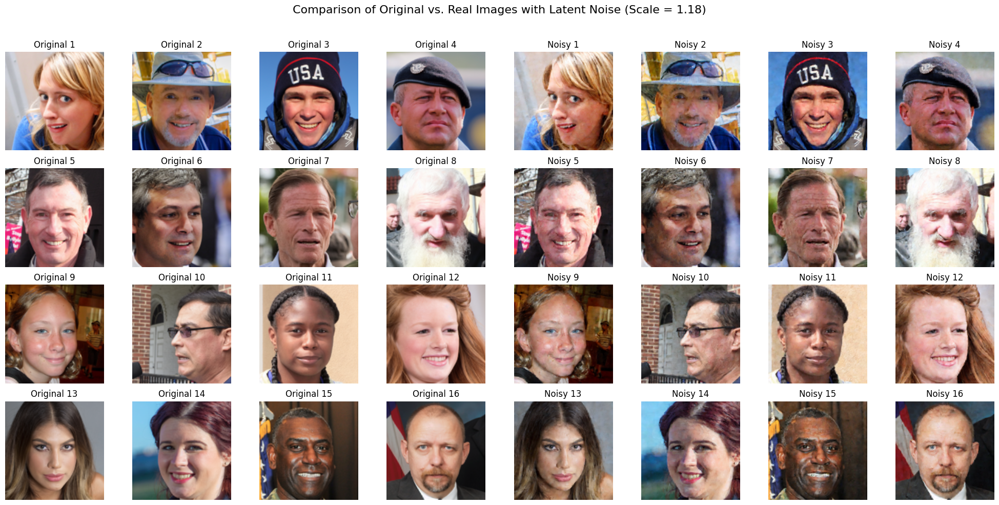

In [10]:
import torch
from diffusers import AutoencoderKL
from PIL import Image
import torchvision.transforms as transforms
import glob
import random
import matplotlib.pyplot as plt
import numpy as np


def load_stable_diffusion_vae(model_id="runwayml/stable-diffusion-v1-5"):
    """
    Load the VAE from Stable Diffusion model.
    """
    vae = AutoencoderKL.from_pretrained(model_id, subfolder="vae")
    return vae

def process_batch_and_reconstruct(image_batch, vae_model, noise_scale, device='cuda'):
    """
    Encodes a batch of images, adds scaled noise, and decodes them back.

    Args:
        image_batch: Tensor of shape (N, 3, H, W)
        vae_model: VAE model (e.g., AutoencoderKL)
        noise_scale: The factor to scale the noise
        device: Device to run computation on

    Returns:
        tuple: (original_recons, noisy_recons)
        original_recons: A list of PIL Images reconstructed from original latents
        noisy_recons: A list of PIL Images reconstructed from noisy latents
    """
    # Ensure model is in eval mode and on correct device
    vae_model.eval()
    vae_model = vae_model.to(device)

    # 1. Preprocess the image batch to [-1, 1] range
    # The load_images_from_folder function returns tensors in [0, 1]
    image_batch = image_batch.to(device) * 2.0 - 1.0

    # 2. Encode to latent space
    with torch.no_grad():
        posterior = vae_model.encode(image_batch).latent_dist
        latents = posterior.mode()
    
    # 3. Add scaled noise to latents
    noise = torch.randn_like(latents) * noise_scale
    noisy_latents = latents + noise

    # 4. Decode the original and noisy latents back to image space
    with torch.no_grad():
        original_recon_tensor = vae_model.decode(latents).sample
        noisy_recon_tensor = vae_model.decode(noisy_latents).sample

    # 5. Post-process tensors to [0, 1] and convert to PIL Images
    original_recons = []
    noisy_recons = []
    for i in range(image_batch.shape[0]):
        # Convert from [-1, 1] to [0, 1] and clamp
        orig_img = (original_recon_tensor[i] / 2 + 0.5).clamp(0, 1)
        noisy_img = (noisy_recon_tensor[i] / 2 + 0.5).clamp(0, 1)
        
        # Convert to PIL Image
        original_recons.append(transforms.ToPILImage()(orig_img.cpu()))
        noisy_recons.append(transforms.ToPILImage()(noisy_img.cpu()))

    return original_recons, noisy_recons


def visualize_grid(original_images, noisy_images, title="", num_images=16):
    """
    Displays two grids side-by-side: original and noisy images.
    """
    fig, axs = plt.subplots(4, 8, figsize=(20, 10))
    fig.suptitle(title, fontsize=16)

    for i in range(num_images):
        # Original images in the first 4 columns
        ax_orig = axs[i // 4, i % 4]
        ax_orig.imshow(original_images[i])
        ax_orig.set_title(f"Original {i+1}")
        ax_orig.axis('off')
        
        # Noisy images in the last 4 columns
        ax_noisy = axs[i // 4, (i % 4) + 4]
        ax_noisy.imshow(noisy_images[i])
        ax_noisy.set_title(f"Noisy {i+1}")
        ax_noisy.axis('off')

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

# --- Main Execution ---
if __name__ == "__main__":
    device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
    
    # TODO: REPLACE WITH THE PATH TO YOUR IMAGE FOLDER
    image_folder = "/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq"
    
    # Define the noise scale based on your previous calculations
    # scaling_factor = std_generated / std_real = 5.0523 / 4.2925
    noise_scale = 1.177
    
    try:
        # Load a batch of 16 real images
        batch_size = 16
        real_images_tensor = load_images_from_folder(image_folder, image_size=(512, 512), max_images=batch_size, seed=42)
        print(f"Loaded a batch of {real_images_tensor.shape[0]} images.")
        
        # Load VAE model
        vae = load_stable_diffusion_vae()
        
        # Process the batch and get the original and noisy reconstructed images
        original_recons, noisy_recons = process_batch_and_reconstruct(real_images_tensor, vae, noise_scale, device)
        
        # Visualize the grids
        visualize_grid(original_recons, noisy_recons, title=f"Comparison of Original vs. Real Images with Latent Noise (Scale = {noise_scale:.2f})")
        
    except ValueError as e:
        print(f"Error: {e}")
        print("Please check if the 'image_folder' path is correct and contains images.")
    except Exception as e:
        print(f"An unexpected error occurred: {e}")


#### TEST Prediction

Initializing VAE model...
VAE model loaded.
Initializing LLaVA Oracle...
Oracle initialized.
Loaded 16 images.

=== Testing with noise scale: 1.50 ===


100%|██████████| 16/16 [00:07<00:00,  2.26it/s]


Predictions saved to predictions_noise_1_50.csv


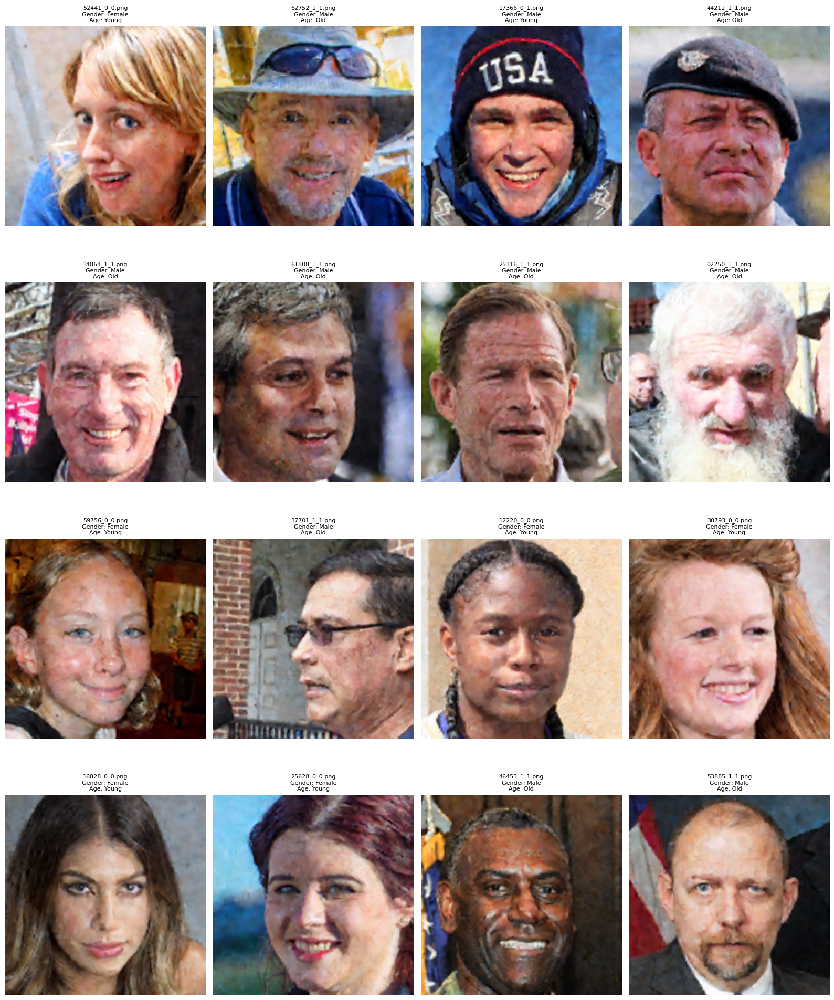


=== Testing with noise scale: 2.00 ===


100%|██████████| 16/16 [00:06<00:00,  2.31it/s]


Predictions saved to predictions_noise_2_00.csv


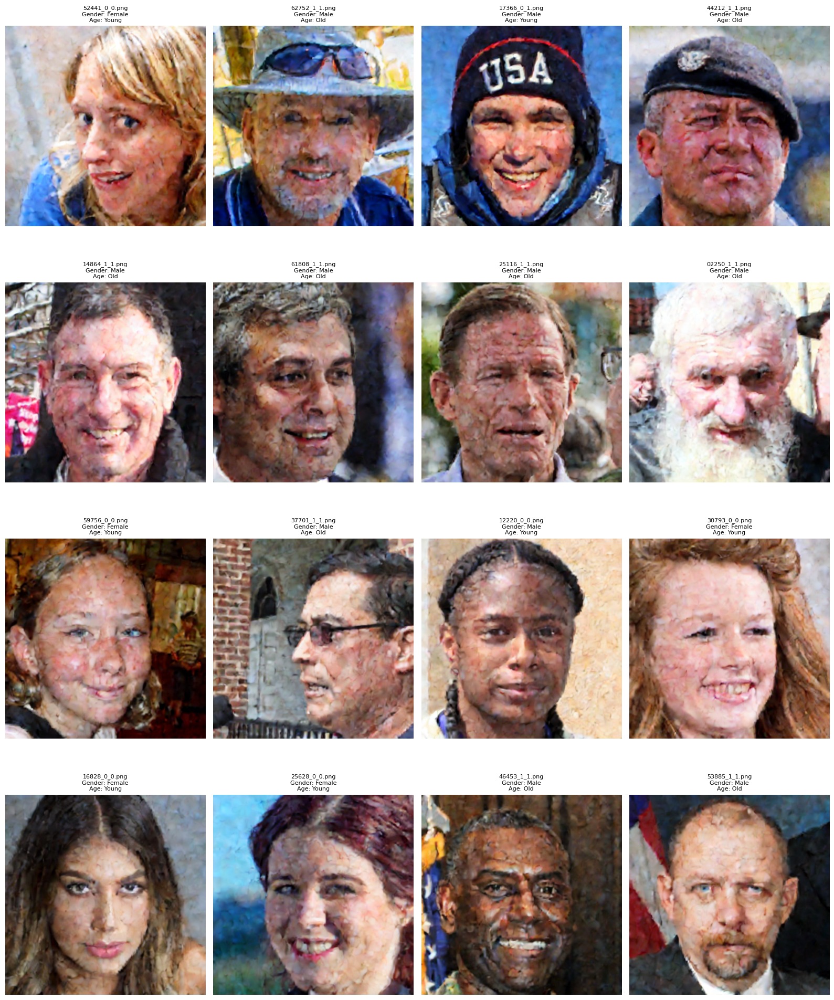

In [ ]:
import os
import torch
import torch.nn.functional as F
from diffusers import AutoencoderKL
from PIL import Image
import torchvision.transforms as transforms
import glob
import random
import matplotlib.pyplot as plt
import numpy as np
import csv
from tqdm import tqdm # Assuming tqdm is installed for the progress bar

# --- User-Provided Functions ---

def load_images_from_folder(folder, image_size=(64, 64), max_images=None, seed=None):
    """
    Load up to max_images randomly sampled from a folder and return a batch tensor (N, C, H, W).
    If max_images is None, load all images.
    """
    if seed is not None:
        random.seed(seed)  # reproducibility

    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    all_files = glob.glob(os.path.join(folder, '**', '*.[jp][pn]g'), recursive=True)

    if not all_files:
        raise ValueError(f"No images found in {folder}")

    if max_images is not None and max_images < len(all_files):
        sampled_files = random.sample(all_files, max_images)
    else:
        sampled_files = all_files

    return sampled_files  # Return tensor and filenames

def parse_filename(filename):
    """
    Parses the filename to extract real age and gender.
    Format: xxxxx_A_G.png where A=age (1 young, 0 old) and G=gender (1 male, 0 female).
    """
    try:
        base_name = os.path.splitext(os.path.basename(filename))[0]
        parts = base_name.split('_')
        age_code = int(parts[-2])
        gender_code = int(parts[-1])
        real_age = 'Young' if age_code == 0 else 'Old'
        real_gender = 'Male' if gender_code == 1 else 'Female'
        return real_age, real_gender
    except (IndexError, ValueError) as e:
        print(f"Warning: Could not parse filename {filename}. Error: {e}")
        return 'Unknown', 'Unknown'

def save_predictions_to_csv(filenames, gender_preds, age_preds, real_genders, real_ages, noise_label):
    """Saves image filenames and predictions to a CSV file with real values."""
    output_filename = f'predictions_noise_{noise_label}.csv'
    with open(output_filename, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['Image Filename', 'Gender Prediction', 'Real Gender', 'Age Prediction', 'Real Age'])
        for i in range(len(filenames)):
            writer.writerow([os.path.basename(filenames[i]), gender_preds[i], real_genders[i], age_preds[i], real_ages[i]])
    print(f"Predictions saved to {output_filename}")

# --- Latent Space Functions ---

def load_stable_diffusion_vae(model_id="runwayml/stable-diffusion-v1-5"):
    """
    Load the VAE from Stable Diffusion model.
    """
    vae = AutoencoderKL.from_pretrained(model_id, subfolder="vae")
    return vae

def process_and_reconstruct_with_noise(image, vae_model, noise_scale, device='cuda'):
    """
    Encodes an image, adds scaled noise, and decodes it back.

    Args:
        image: PIL Image
        vae_model: VAE model (e.g., AutoencoderKL)
        noise_scale: The factor to scale the noise
        device: Device to run computation on

    Returns:
        PIL.Image: The reconstructed image with noise added in latent space.
    """
    vae_model.eval()
    vae_model = vae_model.to(device)

    transform = transforms.Compose([
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5])
    ])
    image_tensor = transform(image).unsqueeze(0).to(device)

    with torch.no_grad():
        posterior = vae_model.encode(image_tensor).latent_dist
        latents = posterior.mode()
    
    noise = torch.randn_like(latents) * noise_scale
    noisy_latents = latents + noise

    with torch.no_grad():
        noisy_image_tensor = vae_model.decode(noisy_latents).sample

    noisy_image = (noisy_image_tensor / 2 + 0.5).clamp(0, 1)
    return transforms.ToPILImage()(noisy_image.squeeze(0).cpu())

        
def visualize_predictions(images, filenames, gender_preds, age_preds, num_images=16):
    """
    Displays a grid of images with their filename, gender, and age predictions.
    """
    n_cols = 4
    n_rows = (num_images + n_cols - 1) // n_cols 
    fig, axs = plt.subplots(n_rows, n_cols, figsize=(4 * n_cols, 5 * n_rows))
    axs = axs.flatten()
    
    for i in range(num_images):
        if i >= len(images):
            axs[i].axis('off')
            continue
            
        img = images[i]
        filename = os.path.basename(filenames[i])
        gender_pred = gender_preds[i]
        age_pred = age_preds[i]
        
        axs[i].imshow(img)
        title = f"{filename}\nGender: {gender_pred}\nAge: {age_pred}"
        axs[i].set_title(title, fontsize=8)
        axs[i].axis('off')
        
    plt.tight_layout()
    plt.show()

# --- Main Execution ---

if __name__ == "__main__":
    device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
    
    # TODO: REPLACE WITH THE PATH TO YOUR IMAGE FOLDER
    image_folder = "/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq"
    
    # Define the noise scales based on your previous calculations
    noise_scales = [0.5, 1.0, 1.18, 1.5, 2.0]
    
    try:
        print("Initializing VAE model...")
        vae = load_stable_diffusion_vae()
        print("VAE model loaded.")

        print("Initializing LLaVA Oracle...")
        # NOTE: You must replace this with your actual LlavaOracle implementation
        oracle = LlavaOracle()
        print("Oracle initialized.")
        
        # Load a batch of real images
        batch_size = 16  # Load all images
        image_filenames = load_images_from_folder(image_folder, image_size=(512, 512), max_images=batch_size, seed=42)
        print(f"Loaded {len(image_filenames)} images.")

        # Loop over each noise level
        for noise_scale in noise_scales:
            print(f"\n=== Testing with noise scale: {noise_scale:.2f} ===")
            
            gender_predictions = []
            age_predictions = []
            real_genders = []
            real_ages = []
            noisy_images_for_vis = []
            
            # Process each image in the batch
            for i in tqdm(range(len(image_filenames))):
                image_path = image_filenames[i]
                original_pil_image = Image.open(image_path).convert("RGB")
                
                # Add latent space noise
                noisy_pil_image = process_and_reconstruct_with_noise(original_pil_image, vae, noise_scale, device)
                noisy_images_for_vis.append(noisy_pil_image)
                
                # Get predictions from the oracle
                gender_pred = oracle.predict_gender([noisy_pil_image])[0]
                age_pred = oracle.predict_age([noisy_pil_image])[0]
                
                # Get ground truth
                real_age, real_gender = parse_filename(image_path)
                
                # Store results
                gender_predictions.append('Male' if gender_pred == 1 else 'Female')
                age_predictions.append('Young' if age_pred == 1 else 'Old')
                real_genders.append(real_gender)
                real_ages.append(real_age)
                
            # Save results to a CSV file
            # save_predictions_to_csv(image_filenames, gender_predictions, age_predictions, real_genders, real_ages, f"{noise_scale:.2f}".replace('.', '_'))

            # Visualize a subset of images
            num_images_to_show = 16
            visualize_predictions(
                noisy_images_for_vis[:num_images_to_show],
                image_filenames[:num_images_to_show],
                gender_predictions[:num_images_to_show],
                age_predictions[:num_images_to_show],
                num_images=num_images_to_show
            )
            
    except ValueError as e:
        print(f"Error: {e}")
        print("Please check if the 'image_folder' path is correct and contains images.")
    except Exception as e:
        print(f"An unexpected error occurred: {e}")


Selected images per group: {'Young-Female': '/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq/0.5pct/align/0/52441_0_0.png', 'Young-Male': '/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq/test/17366_0_1.png', 'Old-Female': '/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq/test/42824_1_0.png', 'Old-Male': '/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq/0.5pct/align/1/62752_1_1.png'}


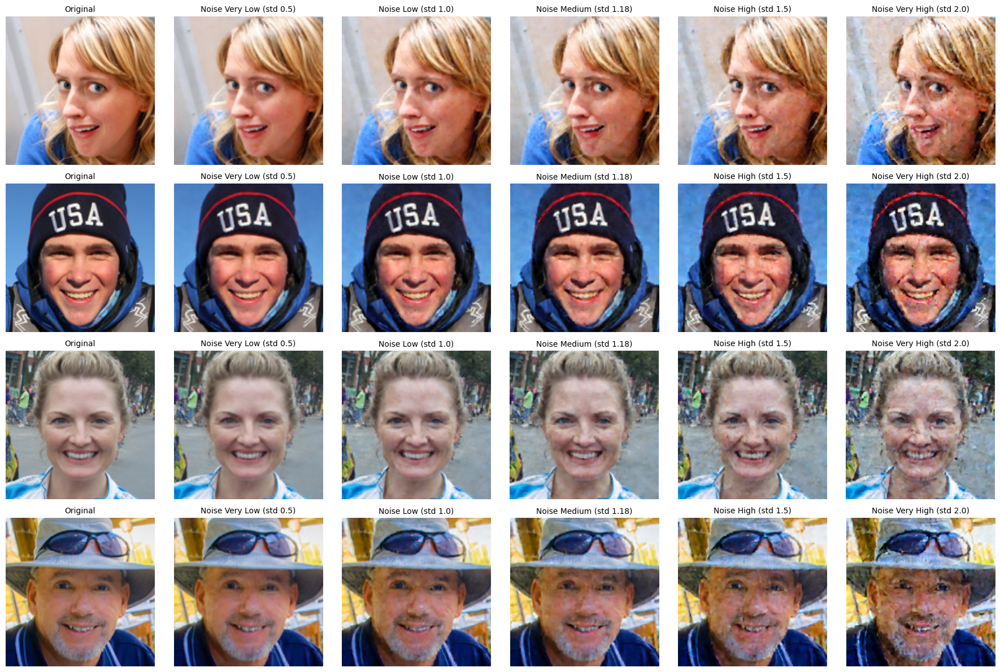

In [11]:
def select_one_per_group(image_filenames):
    """
    Pick one image per group (Young-Female, Young-Male, Old-Female, Old-Male).
    """
    groups = {"Young-Female": None, "Young-Male": None, "Old-Female": None, "Old-Male": None}
    for f in image_filenames:
        age, gender = parse_filename(f)
        group = f"{age}-{gender}"
        if group in groups and groups[group] is None:
            groups[group] = f
        if all(v is not None for v in groups.values()):
            break
    return groups


def visualize_noise_grid(groups, vae, noise_scales, noise_levels, device="cuda"):
    """
    Show grid: rows=groups, cols=noise levels (including original).
    """
    group_names = list(groups.keys())
    n_rows = len(group_names)
    n_cols = len(noise_scales) + 1  # include original

    fig, axs = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols, 3 * n_rows))

    for row, group in enumerate(group_names):
        image_path = groups[group]
        original_pil_image = Image.open(image_path).convert("RGB")

        # First col: original
        axs[row, 0].imshow(original_pil_image)
        axs[row, 0].set_title("Original", fontsize=10)
        axs[row, 0].axis("off")

        # Noised versions
        for col, noise_scale in enumerate(noise_scales, start=1):
            noisy_pil_image = process_and_reconstruct_with_noise(
                original_pil_image, vae, noise_scale, device
            )
            axs[row, col].imshow(noisy_pil_image)
            axs[row, col].set_title(f"Noise {noise_levels[col-1]} (std {noise_scale})", fontsize=10)
            axs[row, col].axis("off")

        axs[row, 0].set_ylabel(group, fontsize=12, rotation=90, labelpad=10)

    plt.tight_layout()
    plt.show()


# --- Usage Example ---
if __name__ == "__main__":
    device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
    image_folder = "/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq"

    # Load candidate images
    image_filenames = load_images_from_folder(image_folder, image_size=(512, 512), max_images=200, seed=42)

    # Select 1 per group
    groups = select_one_per_group(image_filenames)
    print("Selected images per group:", groups)

    # Load VAE
    vae = load_stable_diffusion_vae().to(device)

    # Define noise scales
    noise_scales = [0.5, 1.0, 1.18, 1.5, 2.0]

    noise_levels = ["Very Low", "Low", "Medium", "High", "Very High"]

    # Visualize
    visualize_noise_grid(groups, vae, noise_scales, noise_levels, device)


#### Pixel-Space noise addition

In [ ]:
import os
import torch
from PIL import Image
import random
from torchvision import transforms

def load_images_from_folder(folder, image_size=(64, 64), max_images=None, seed=None):
    """
    Load up to max_images randomly sampled from a folder and return a batch tensor (N, C, H, W).
    If max_images is None, load all images.
    """
    if seed is not None:
        random.seed(seed)  # reproducibility

    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor()
    ])

    # Collect valid image paths
    all_files = [
        os.path.join(folder, f) for f in os.listdir(folder)
        if os.path.isfile(os.path.join(folder, f)) and f.lower().endswith((".png", ".jpg", ".jpeg"))
    ]

    if not all_files:
        raise ValueError(f"No images found in {folder}")

    # Randomly sample
    if max_images is not None and max_images < len(all_files):
        sampled_files = random.sample(all_files, max_images)
    else:
        sampled_files = all_files

    images = []
    for filepath in sampled_files:
        img = Image.open(filepath).convert("RGB")
        img = transform(img)
        images.append(img)

    return torch.stack(images, dim=0)  # (N, C, H, W)


def measure_noise_level(batch_A: torch.Tensor, batch_B: torch.Tensor):
    """
    Measure the noise level difference between generated images (A) and real images (B).

    Args:
        batch_A (torch.Tensor): Tensor of generated images with shape (N, C, H, W).
        batch_B (torch.Tensor): Tensor of real images with shape (N, C, H, W).

    Returns:
        dict: {
            'std_A': per-channel std of batch_A,
            'std_B': per-channel std of batch_B,
            'std_noise': per-channel noise std needed to match A's noise level
        }
    """

    # Flatten spatial and batch dimensions, keep channels
    A_flat = batch_A.view(batch_A.shape[0], batch_A.shape[1], -1)
    B_flat = batch_B.view(batch_B.shape[0], batch_B.shape[1], -1)

    # Compute per-channel standard deviations (over batch and pixels)
    std_A = A_flat.std(dim=(0, 2))
    std_B = B_flat.std(dim=(0, 2))

    # Compute noise variance difference
    var_noise = (std_A ** 2) - (std_B ** 2)

    # Clamp to avoid negative due to numerical issues
    var_noise = torch.clamp(var_noise, min=0.0)

    std_noise = torch.sqrt(var_noise)

    return {
        "std_A": std_A,
        "std_B": std_B,
        "std_noise": std_noise
    }

def compute_noise_std(real_batch, generated_batch):
    """
    Computes the noise standard deviation between two batches of images.

    Args:
        real_batch (torch.Tensor): Batch of real images, shape (N, C, H, W)
        generated_batch (torch.Tensor): Batch of generated images, shape (N, C, H, W)

    Returns:
        float: Noise standard deviation
    """
    # Ensure both are float tensors
    real_batch = real_batch.float()
    generated_batch = generated_batch.float()
    
    # Compute pixel-wise difference
    diff = real_batch - generated_batch
    
    # Flatten and compute std
    noise_std = diff.view(-1).std().item()
    
    return noise_std

# Example usage:
if __name__ == "__main__":

    real_folder = "/home/ani/bias_ddpm/DiffusingDeBias/DiffusingBias/data/bffhq/bffhq/0.5pct/align/0"
    generated_folder = "/data05/ani/individual_samples"


    # Take 300 random images from each folder
    batch_real = load_images_from_folder(real_folder, image_size=(64, 64), max_images=5000, seed=42)
    batch_generated = load_images_from_folder(generated_folder, image_size=(64, 64), max_images=5000, seed=42)

    # results = measure_noise_level(batch_generated, batch_real)
    result = compute_noise_std(batch_real, batch_generated)

    print("Noise std between real and generated:", result)

    # print("Std(Generated):", results["std_A"])
    # print("Std(Real):", results["std_B"])
    # print("Required noise std to add to real:", results["std_noise"])



Std(Generated): tensor([0.4211, 0.4133, 0.4102])
Std(Real): tensor([0.2761, 0.2532, 0.2512])
Required noise std to add to real: tensor([0.3180, 0.3266, 0.3242])


In [ ]:
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2

class AddGaussianNoise(A.ImageOnlyTransform):
    def __init__(self, variance=0.01, always_apply=False, p=1.0):
        """
        Args:
            variance (float): fixed variance of the Gaussian noise
            p (float): probability of applying noise
        """
        super().__init__(always_apply, p)
        self.variance = variance
        self.sigma = np.sqrt(variance)

    def apply(self, img, **params):
        # Fixed variance (same for all images)
        noise = np.random.normal(0, self.sigma, img.shape).astype(np.float32)

        noisy = img.astype(np.float32) / 255.0
        noisy = np.clip(noisy + noise, 0.0, 1.0)
        return (noisy * 255).astype(np.uint8)

classify_imagesWithNoise = True  # Set to True to classify noisy images

if classify_imagesWithNoise:
    print("Classifying noisy images")
    transform = A.Compose([
        A.Resize(64, 64),
        # AddGaussianNoise(var_min=0.001, var_max=0.02, p=1.0),  # random per image
        AddGaussianNoise(variance=0.01, p=1.0), 
        A.Normalize(mean=[0.485, 0.456, 0.406], 
                    std=[0.229, 0.224, 0.225]),
        ToTensorV2()
    ])
else:
    print("Classifying clean images")
    transform = A.Compose([
        A.Resize(64, 64),
        A.Normalize(mean=[0.485, 0.456, 0.406], 
                    std=[0.229, 0.224, 0.225]),
        ToTensorV2()
    ])


Classifying noisy images


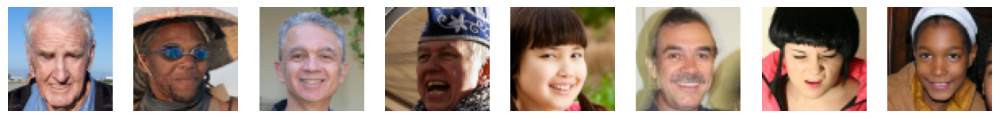

In [ ]:
import os
import pandas as pd
from PIL import Image
from torch.utils.data import DataLoader
from himyb.datasets.bffhq import BFFHQ

dataset = BFFHQ(
            root="./data",
            env="train",
            bias_amount=0.995,
            transform=transform,
            return_index=False,
            class_label=None
        )
dataloader = DataLoader(
            dataset, batch_size=32, shuffle=True, num_workers=2, drop_last=True, pin_memory=True)

# Visualize a batch of images
import matplotlib.pyplot as plt

# Get one batch
batch = next(iter(dataloader))
if isinstance(batch, dict):
    images = batch['image']
else:
    images = batch[0] if isinstance(batch, (list, tuple)) else batch

# Convert tensor images to numpy and denormalize for visualization
def denormalize(img):
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    img = img.permute(1, 2, 0).cpu().numpy()
    img = std * img + mean
    img = np.clip(img, 0, 1)
    return img

n = min(8, images.shape[0])
plt.figure(figsize=(16, 4))
for i in range(n):
    plt.subplot(1, n, i+1)
    plt.imshow(denormalize(images[i]))
    plt.axis('off')
plt.show()

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import glob
from tqdm import tqdm

# Set the path to the folder containing your test images
IMAGE_FOLDER = "/home/ani/bias_ddpm/data/bffhq"

# Set the number of images to display in the grid
GRID_SIZE = 9

In [68]:
def visualize_predictions(images, image_paths, genders, ages):
    # Determine the grid dimensions (e.g., 3x3 for 9 images)
    n = int(GRID_SIZE**0.5)
    fig, axes = plt.subplots(n, n, figsize=(10, 10))

    # Flatten the axes array for easy iteration
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < len(images) and images[i] is not None:
            # Display the image
            ax.imshow(images[i])

            # Set the title with the predictions
            title_text = f"Path: {os.path.basename(image_paths[i])}\nGender: {genders[i]}\nAge: {ages[i]}"
            ax.set_title(title_text, fontsize=8)

            # Hide the axis ticks
            ax.axis('off')
        else:
            ax.axis('off') # Hide empty subplots

    plt.tight_layout()
    plt.show()


In [ ]:
import random
import os
import csv
import cv2
import numpy as np

def add_gaussian_noise(image, mean=0.0, std=0.1):
    """
    Add Gaussian noise to an RGB image (H, W, C) in uint8 [0,255] format.
    Args:
        image (np.ndarray): Input image (uint8).
        mean (float): Mean of Gaussian noise (in [0,1] scale).
        std (float or list): Std of Gaussian noise (in [0,1] scale). 
                             Can be a single float or list of 3 values for RGB.
    Returns:
        np.ndarray: Noisy image (uint8).
    """
    # Convert to float in [0,1]
    img = image.astype(np.float32) / 255.0

    # Ensure std is numpy array with shape (1,1,3)
    std = np.array(std, dtype=np.float32).reshape(1, 1, -1)

    # Add Gaussian noise
    noise = np.random.normal(mean, std, img.shape).astype(np.float32)
    noisy = img + noise
    noisy = np.clip(noisy, 0.0, 1.0)

    # Convert back to uint8
    return (noisy * 255).astype(np.uint8)


def parse_filename(filename):
    """
    Parses the filename to extract real age and gender.
    Format: xxxxx_A_G.png where A=age (1 young, 0 old) and G=gender (1 male, 0 female).
    """
    try:
        # Get the base filename without the extension
        base_name = os.path.splitext(filename)[0]
        # Split the string by underscores
        parts = base_name.split('_')
        # The last two parts are the age and gender
        age_code = int(parts[-2])
        gender_code = int(parts[-1])

        # Convert codes to descriptive text
        real_age = 'Young' if age_code == 0 else 'Old'
        real_gender = 'Male' if gender_code == 1 else 'Female'

        return real_age, real_gender
    except (IndexError, ValueError) as e:
        print(f"Warning: Could not parse filename {filename}. Error: {e}")
        return 'Unknown', 'Unknown'

def save_predictions_to_csv(filenames, gender_preds, age_preds, real_genders, real_ages, noise_label):
    """Saves image filenames and predictions to a CSV file with real values."""
    output_filename = f'predictions_noise_{noise_label}.csv'
    with open(output_filename, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['Image Filename', 'Gender Prediction', 'Real Gender', 'Age Prediction', 'Real Age'])
        for i in range(len(filenames)):
            writer.writerow([filenames[i], gender_preds[i], real_genders[i], age_preds[i], real_ages[i]])
    print(f"Predictions saved to {output_filename}")

def main():
    # Example baseline noise from your stats
    baseline_std = [0.3180, 0.3266, 0.3242]

    # Define noise levels
    noise_levels = {
        "very_low":   [s * 0.25 for s in baseline_std],
        "low":        [s * 0.50 for s in baseline_std],
        "medium":     [s * 0.75 for s in baseline_std],
        "baseline":   baseline_std,
        "high":       [s * 1.25 for s in baseline_std],
        "very_high":  [s * 1.50 for s in baseline_std],
    }

    print("Initializing LLaVA Oracle...")
    oracle = LlavaOracle()
    print("Oracle initialized.")

    image_paths = glob.glob(os.path.join(IMAGE_FOLDER, "**", "*.[pj][pn]g"), recursive=True)
    selected_images = random.sample(image_paths, min(GRID_SIZE, len(image_paths)))

    # Loop over noise levels
    for noise_label, noise_std in noise_levels.items():
        print(f"\n=== Testing with noise level: {noise_label} (std={noise_std}) ===")

        pil_images = []
        path_images = []
        gender_predictions = []
        age_predictions = []
        real_genders = []
        real_ages = []

        for image_path in tqdm(image_paths):
            try:
                pil_image = Image.open(image_path).convert('RGB')

                # Add noise if requested
                if classify_imagesWithNoise:
                    noisy = add_gaussian_noise(np.array(pil_image), mean=0.0, std=noise_std)
                    pil_image = Image.fromarray(noisy)

                # Predict with oracle
                gender_pred = oracle.predict_gender([pil_image])[0]
                age_pred = oracle.predict_age([pil_image])[0]

                # Ground truth
                real_age, real_gender = parse_filename(image_path)

                # Store results
                pil_images.append(pil_image)
                path_images.append(image_path)
                gender_predictions.append('Male' if gender_pred == 1 else 'Female' if gender_pred == 0 else 'Unknown')
                age_predictions.append('Young' if age_pred == 1 else 'Old' if age_pred == 0 else 'Unknown')
                real_genders.append(real_gender)
                real_ages.append(real_age)

            except Exception as e:
                print(f"Could not process {image_path}: {e}")
                pil_images.append(None)
                path_images.append(image_path)
                gender_predictions.append('Error')
                age_predictions.append('Error')

        # Save results for this noise level
        save_predictions_to_csv(path_images, gender_predictions, age_predictions, real_genders, real_ages, noise_label)

        # Visualize only for the first GRID_SIZE images
        n = GRID_SIZE
        pil_images = pil_images[:n]
        selected_images = selected_images[:n]
        gender_predictions = gender_predictions[:n]
        age_predictions = age_predictions[:n]
        visualize_predictions(pil_images[:n], selected_images[:n], gender_predictions[:n], age_predictions[:n])

Initializing LLaVA Oracle...
Oracle initialized.

=== Testing with noise level: very_low (std=[0.0795, 0.08165, 0.08105]) ===


  0%|          | 0/21200 [00:00<?, ?it/s]

100%|██████████| 21200/21200 [1:39:01<00:00,  3.57it/s]


Predictions saved to predictions_noise_very_low.csv


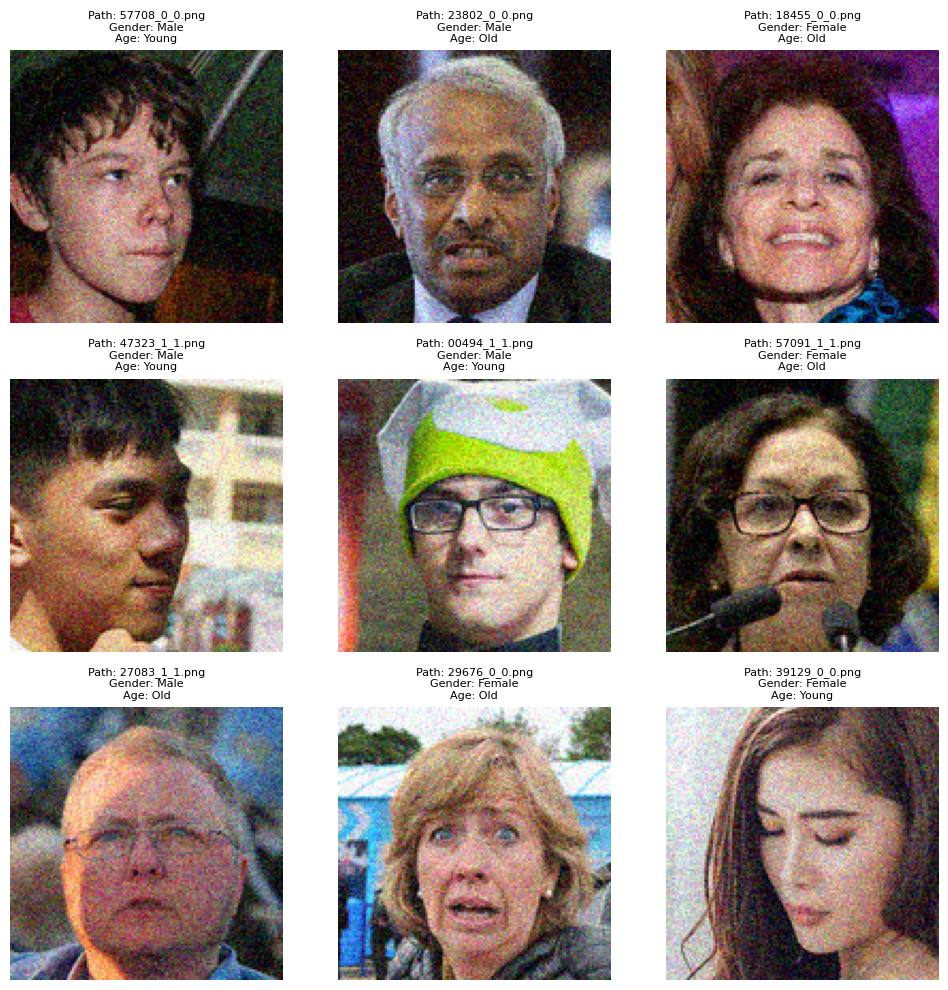


=== Testing with noise level: low (std=[0.159, 0.1633, 0.1621]) ===


100%|██████████| 21200/21200 [1:39:16<00:00,  3.56it/s]


Predictions saved to predictions_noise_low.csv


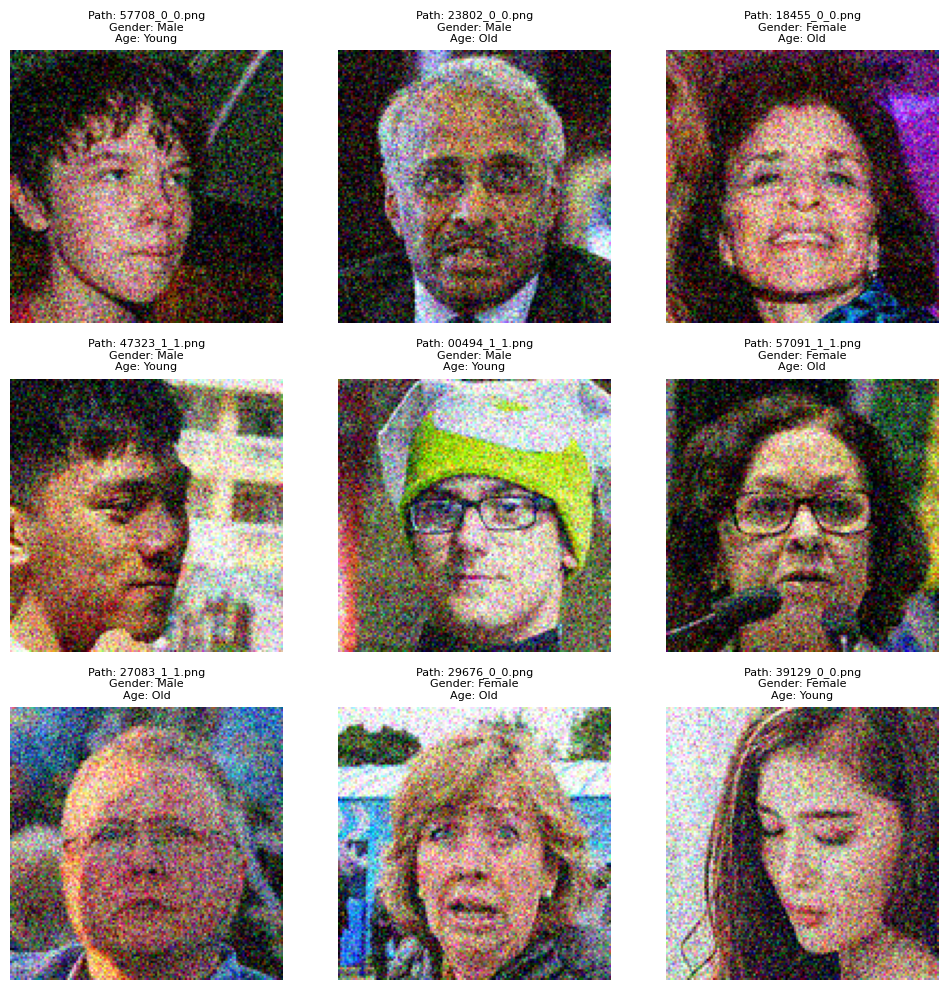


=== Testing with noise level: medium (std=[0.2385, 0.24495, 0.24314999999999998]) ===


100%|██████████| 21200/21200 [1:39:21<00:00,  3.56it/s]


Predictions saved to predictions_noise_medium.csv


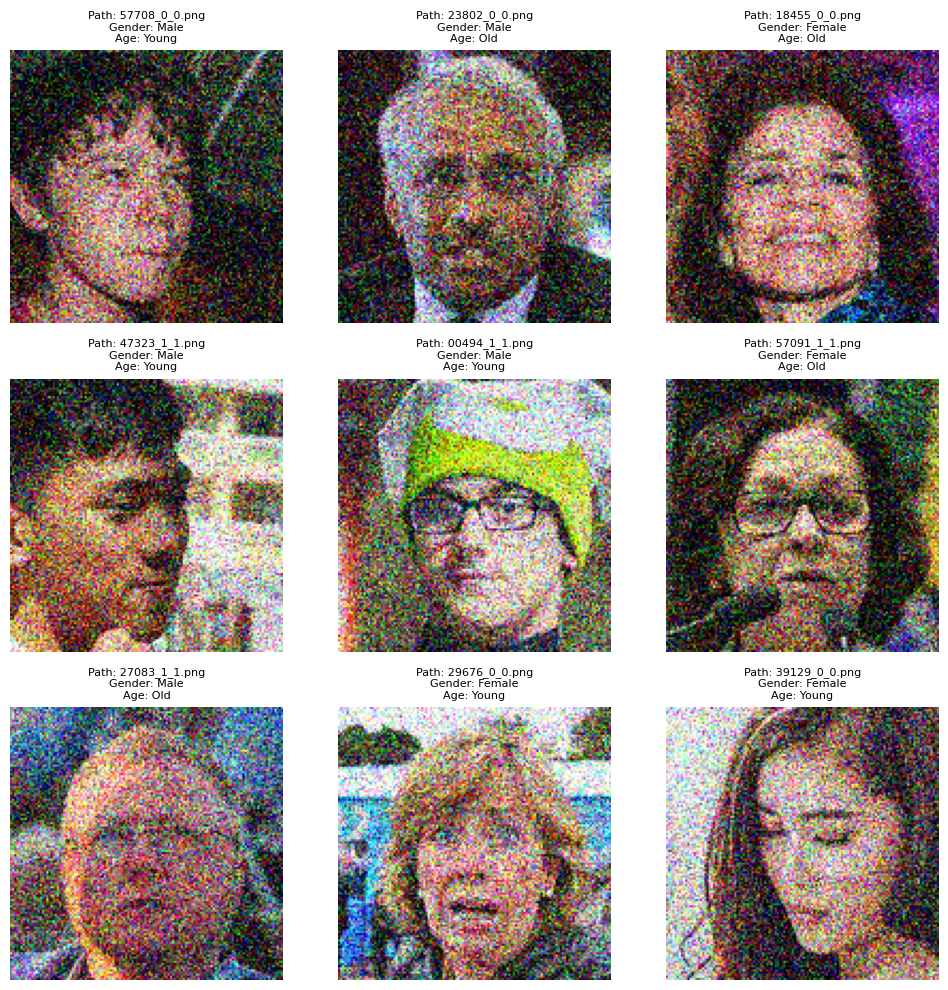


=== Testing with noise level: baseline (std=[0.318, 0.3266, 0.3242]) ===


100%|██████████| 21200/21200 [1:39:29<00:00,  3.55it/s]


Predictions saved to predictions_noise_baseline.csv


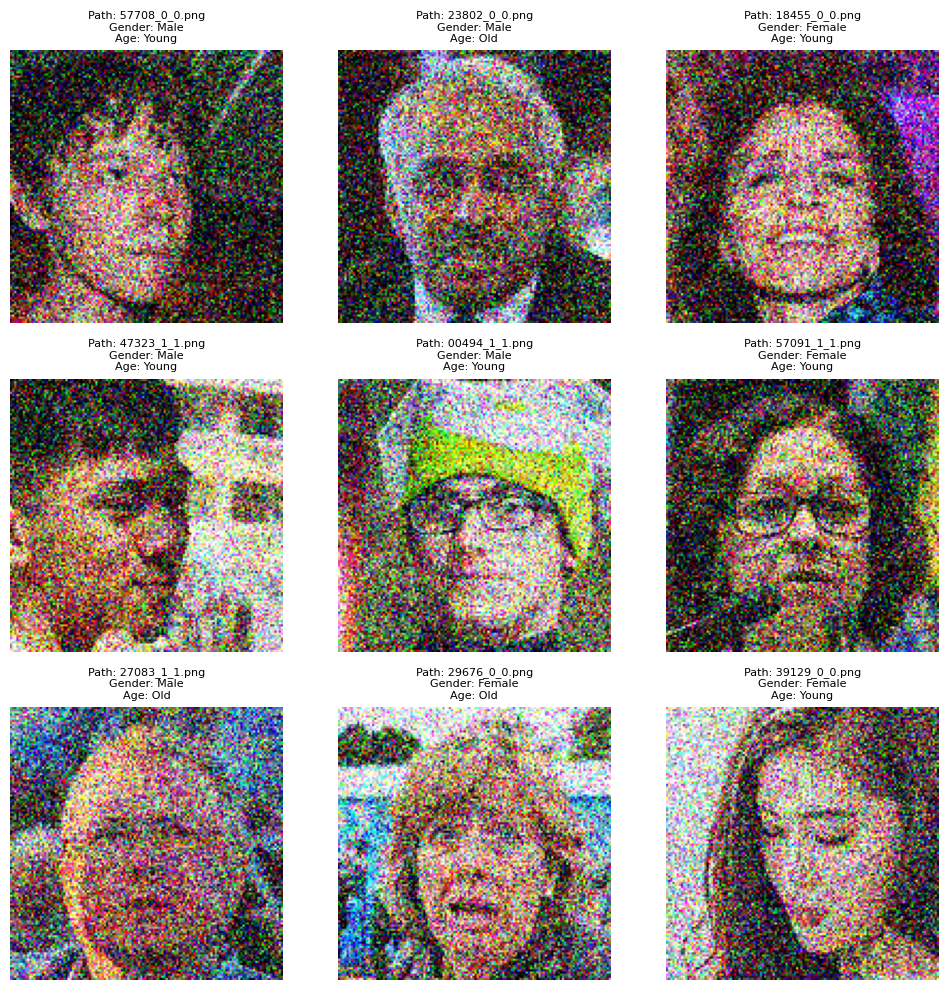


=== Testing with noise level: high (std=[0.3975, 0.40825, 0.40525]) ===


100%|██████████| 21200/21200 [1:39:26<00:00,  3.55it/s]


Predictions saved to predictions_noise_high.csv


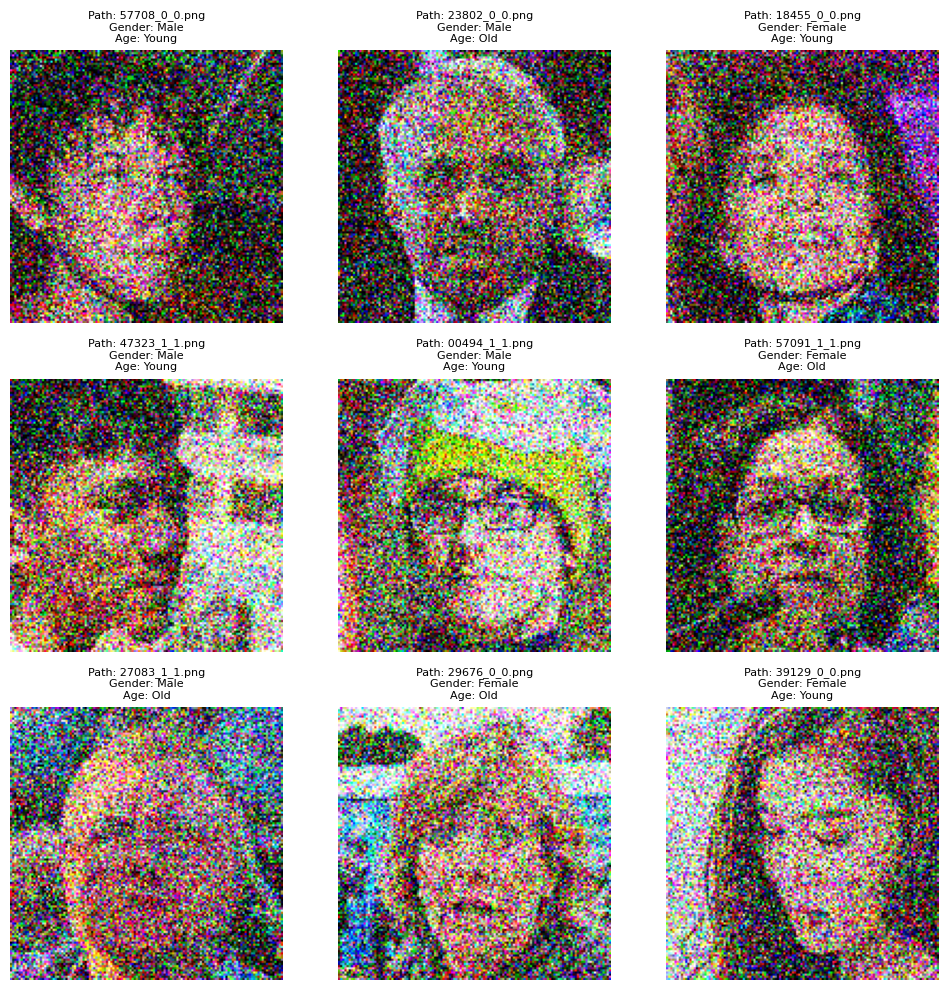


=== Testing with noise level: very_high (std=[0.477, 0.4899, 0.48629999999999995]) ===


100%|██████████| 21200/21200 [1:39:16<00:00,  3.56it/s]


Predictions saved to predictions_noise_very_high.csv


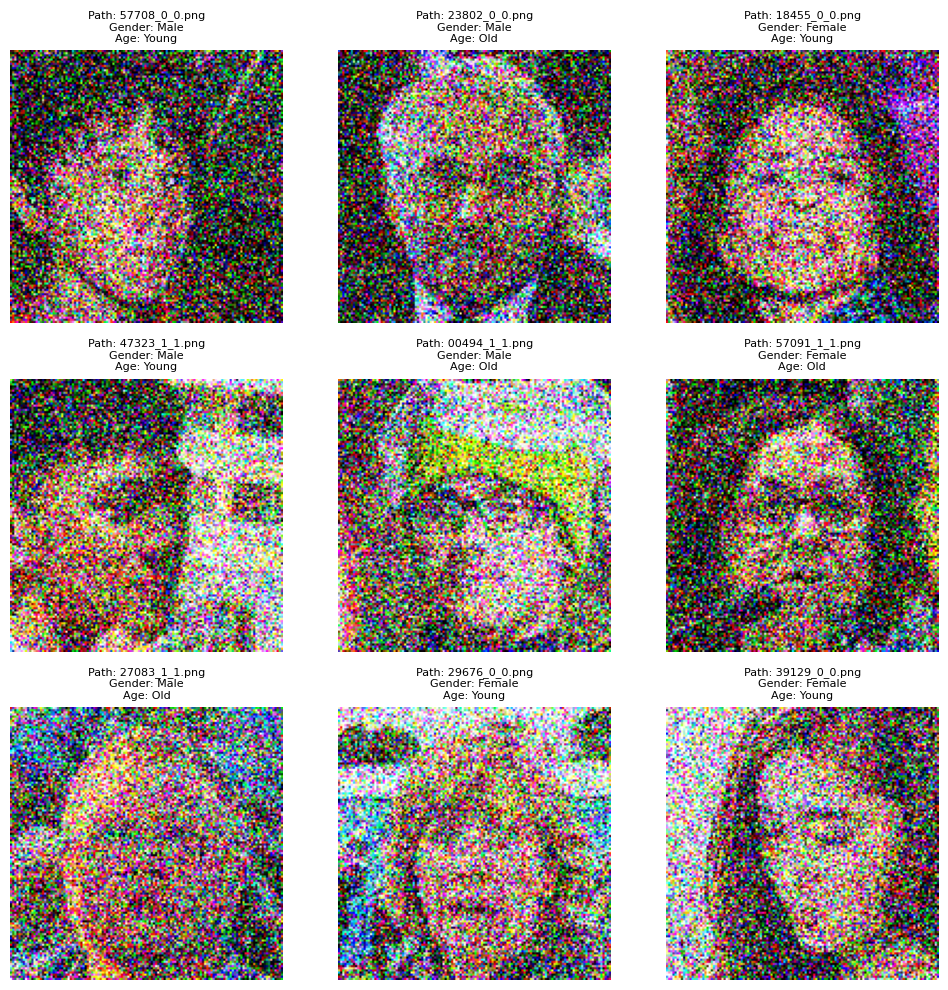

In [71]:
main()

In [72]:
import csv
from collections import defaultdict
from scipy.stats import binomtest


def evaluate_predictions(csv_filename='predictions.csv'):
    """
    Evaluates the prediction accuracy from the CSV file, including fine-grained metrics
    and 95% Clopper-Pearson confidence intervals.
    """

    correct_gender = 0
    correct_age = 0
    total_predictions = 0

    # Fine-grained counters
    fine_counts = defaultdict(lambda: {'total': 0, 'correct': 0})

    try:
        with open(csv_filename, mode='r', newline='') as file:
            reader = csv.reader(file)
            header = next(reader)  # Skip the header row

            # Get the column indices from the header to make the code robust
            gender_pred_idx = header.index('Gender Prediction')
            real_gender_idx = header.index('Real Gender')
            age_pred_idx = header.index('Age Prediction')
            real_age_idx = header.index('Real Age')

            for row in reader:
                total_predictions += 1

                real_combo = f"{row[real_age_idx]}-{row[real_gender_idx]}"
                pred_combo = f"{row[age_pred_idx]}-{row[gender_pred_idx]}"
                fine_counts[real_combo]['total'] += 1
                if real_combo == pred_combo:
                    fine_counts[real_combo]['correct'] += 1

                # Check for gender accuracy
                if row[gender_pred_idx] == row[real_gender_idx]:
                    correct_gender += 1

                # Check for age accuracy
                if row[age_pred_idx] == row[real_age_idx]:
                    correct_age += 1

    except FileNotFoundError:
        print(f"Error: The file '{csv_filename}' was not found.")
        return

    # Calculate and print the results
    if total_predictions > 0:
        gender_accuracy = (correct_gender / total_predictions) * 100
        age_accuracy = (correct_age / total_predictions) * 100

        gender_ci = binomtest(correct_gender, total_predictions).proportion_ci(confidence_level=0.95, method="exact")
        age_ci = binomtest(correct_age, total_predictions).proportion_ci(confidence_level=0.95, method="exact")

        print("\n--- Evaluation Results ---")
        print(f"Total predictions evaluated: {total_predictions}")
        print(
            f"Gender Accuracy: {gender_accuracy:.2f}% "
            f"({correct_gender}/{total_predictions}), "
            f"95% CI: [{gender_ci.low*100:.2f}%, {gender_ci.high*100:.2f}%]"
        )
        print(
            f"Age Accuracy: {age_accuracy:.2f}% "
            f"({correct_age}/{total_predictions}), "
            f"95% CI: [{age_ci.low*100:.2f}%, {age_ci.high*100:.2f}%]"
        )

        print("\n--- Fine-grained Accuracy ---")
        for combo in ['Young-Female', 'Young-Male', 'Old-Female', 'Old-Male']:
            total = fine_counts[combo]['total']
            correct = fine_counts[combo]['correct']
            acc = (correct / total * 100) if total > 0 else 0

            if total > 0:
                ci = binomtest(correct, total).proportion_ci(confidence_level=0.95, method="exact")
                print(
                    f"{combo}: {acc:.2f}% ({correct}/{total}), "
                    f"95% CI: [{ci.low*100:.2f}%, {ci.high*100:.2f}%]"
                )
            else:
                print(f"{combo}: No samples")

    else:
        print("No predictions to evaluate.")


print("---------------------------VERY LOW-------------------------------")

evaluate_predictions(csv_filename='predictions_noise_very_low.csv')

print("----------------------------LOW------------------------------")

evaluate_predictions(csv_filename='predictions_noise_low.csv')

print("---------------------------MEDIUM-------------------------------")

evaluate_predictions(csv_filename='predictions_noise_medium.csv')

print("---------------------------BASELINE-----------------------------")

evaluate_predictions(csv_filename='predictions_noise_baseline.csv')

print("------------------------------HIGH----------------------------")

evaluate_predictions(csv_filename='predictions_noise_high.csv')

print("----------------------------VERY HIGH---------------------------")

evaluate_predictions(csv_filename='predictions_noise_very_high.csv')




---------------------------VERY LOW-------------------------------

--- Evaluation Results ---
Total predictions evaluated: 21200
Gender Accuracy: 98.75% (20935/21200), 95% CI: [98.59%, 98.90%]
Age Accuracy: 96.76% (20514/21200), 95% CI: [96.52%, 97.00%]

--- Fine-grained Accuracy ---
Young-Female: 95.28% (9816/10302), 95% CI: [94.86%, 95.68%]
Young-Male: 93.29% (278/298), 95% CI: [89.82%, 95.85%]
Old-Female: 86.58% (258/298), 95% CI: [82.17%, 90.23%]
Old-Male: 96.14% (9904/10302), 95% CI: [95.75%, 96.50%]
----------------------------LOW------------------------------

--- Evaluation Results ---
Total predictions evaluated: 21200
Gender Accuracy: 98.44% (20869/21200), 95% CI: [98.26%, 98.60%]
Age Accuracy: 95.55% (20257/21200), 95% CI: [95.27%, 95.83%]

--- Fine-grained Accuracy ---
Young-Female: 95.15% (9802/10302), 95% CI: [94.71%, 95.55%]
Young-Male: 91.28% (272/298), 95% CI: [87.48%, 94.22%]
Old-Female: 75.17% (224/298), 95% CI: [69.86%, 79.97%]
Old-Male: 93.59% (9642/10302), 95% CI

In [13]:
import scipy.stats
n_correct = 20925
n_total = 21200
results = scipy.stats.binomtest(n_correct, n_total).proportion_ci(0.95,'exact')
print("95% confidence interval:", '[', round(results[0]*100, 2), ',', round(results[1]*100, 2), ']')
n_correct = 20391
n_total = 21200
results = scipy.stats.binomtest(n_correct, n_total).proportion_ci(0.95,'exact')
print("95% confidence interval:", '[', round(results[0]*100, 2), ',', round(results[1]*100, 2), ']')
n_correct = 9771
n_total = 10302
results = scipy.stats.binomtest(n_correct, n_total).proportion_ci(0.95,'exact')
print("95% confidence interval:", '[', round(results[0]*100, 2), ',', round(results[1]*100, 2), ']')
n_correct = 281
n_total = 298
results = scipy.stats.binomtest(n_correct, n_total).proportion_ci(0.95,'exact')
print("95% confidence interval:", '[', round(results[0]*100, 2), ',', round(results[1]*100, 2), ']')
n_correct = 271
n_total = 298
results = scipy.stats.binomtest(n_correct, n_total).proportion_ci(0.95,'exact')
print("95% confidence interval:", '[', round(results[0]*100, 2), ',', round(results[1]*100, 2), ']')
n_correct = 9801
n_total = 10302
results = scipy.stats.binomtest(n_correct, n_total).proportion_ci(0.95,'exact')
print("95% confidence interval:", '[', round(results[0]*100, 2), ',', round(results[1]*100, 2), ']')

95% confidence interval: [ 98.54 , 98.85 ]
95% confidence interval: [ 95.92 , 96.44 ]
95% confidence interval: [ 94.4 , 95.26 ]
95% confidence interval: [ 91.02 , 96.64 ]
95% confidence interval: [ 87.09 , 93.94 ]
95% confidence interval: [ 94.7 , 95.54 ]
